<a href="https://colab.research.google.com/github/Debora-Simoes/IA901-2023S1/blob/main/projetos/Reconhecimento_acao_humana_imagem_drone/notebooks/DataAugmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Montando o drive e importando as bibliotecas

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Importing the necessary libraries
import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image
import shutil
import torchvision
import torch
from torchvision import datasets, models, transforms

### Exemplo de transformações para aumentação dos dados de treino e validação

Nessa seção, testam-se as transformações disponíveis na documentação do Pytorch, adotando uma imagem do conjunto de treino, a fim de verificar se todas as transformações selecionadas previamente podem ser aplicadas aos conjuntos de treino para aumentação dos dados.

In [ ]:
train_dataset = "gdrive/MyDrive/IA901_Projeto/Dados_pre_processing/NC/train/images"
list_files = os.listdir(train_dataset)

In [ ]:
# 10 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files), (10)) # selecionando índices aleatórios do conjunto de dados de treino

In [ ]:
random_samples

array([1380, 1093, 1200,  713,  611, 1229,  647, 1309,  926, 1265])

In [ ]:
list_files[random_samples[0]] # Imagem adotada para os testes

'Drone_005.mp4_t-103.333333.jpg'

**Imagem original do conjunto de dados de treino**

Adotou-se o conjunto de dados de treino correspondentes às imagens em nível de cinza, uma vez que as mesmas apresentaram métricas semelhantes às imagens RBG nos treinamentos realizados anteriormente, porém com tempo computacional reduzido (cerca de 3 vezes menor).

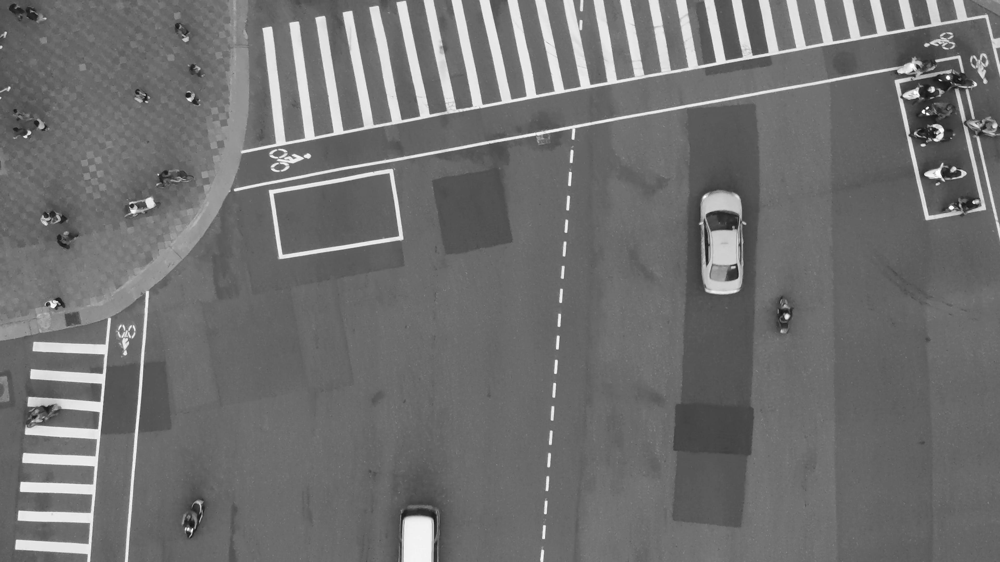

In [ ]:
img_file = train_dataset + '/' + list_files[random_samples[0]]
img = Image.open(img_file)
display(img)

**Informações referentes à imagem original:**

In [ ]:
intensidade  = img.getextrema() # Obtém os valores mínimo e máximo de pixel para cada banda na imagem.

print("\n Dimensões da imagem:",img.size)
print("\n Modo da imagem:",img.mode)
print("\n Menor valor de intensidade de pixel da imagem:",intensidade[0])
print("\n Maior valor de intensidade de pixel da imagem:",intensidade[1])

# Modo L: corresponde a uma imagem monocromática de 8 bits


 Dimensões da imagem: (3840, 2160)

 Modo da imagem: L

 Menor valor de intensidade de pixel da imagem: 0

 Maior valor de intensidade de pixel da imagem: 255


**1 - Verificando o resultado da transformação ColorJitter**

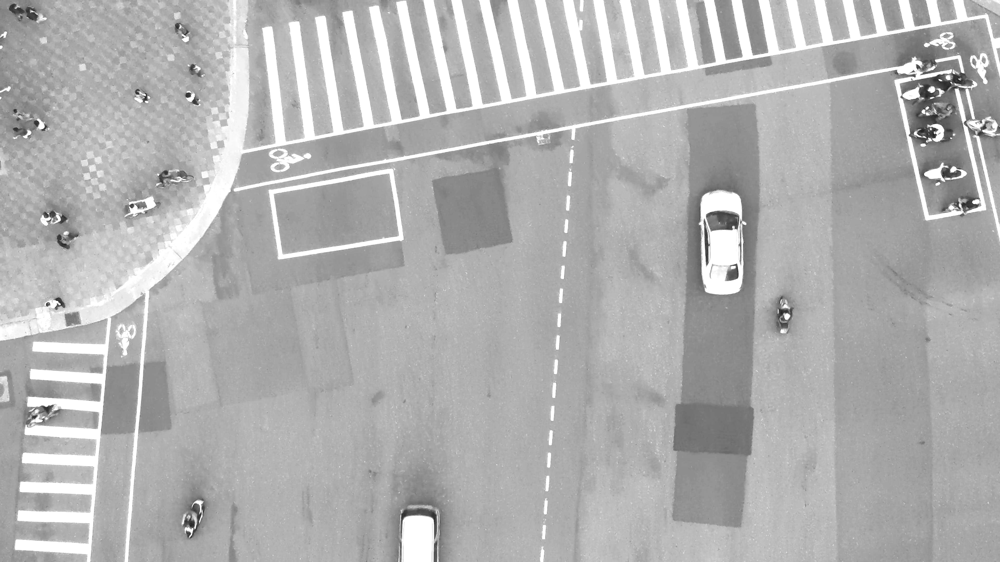

In [ ]:
jitter = transforms.ColorJitter(brightness=.9, hue=0.5) #Altera aleatoriamente o brilho e a saturação da imagem
jitted_img = jitter(img)
jitted_img

**2 - Verificando o resultado da transformação "RandAugment"**

Essa transformação não foi adotada para aumentação dos dados porque rotaciona e translada a imagem e, desse modo, compromete os rótulos da imagem, os quais dependem das coordenadas do bounding box (x_min, x_max, y_min, y_max).

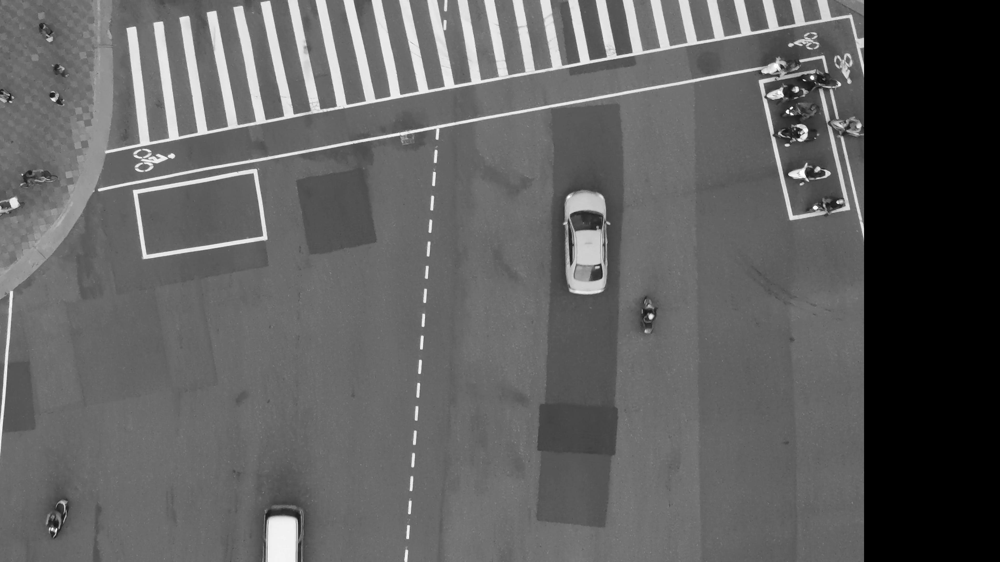

In [ ]:
rand_aug = transforms.RandAugment()
rand_aug_img = rand_aug(img)
rand_aug_img # Não será adotado pois translada a imagem

**3 - Verificando o resultado da transformação "RandomInvert"**

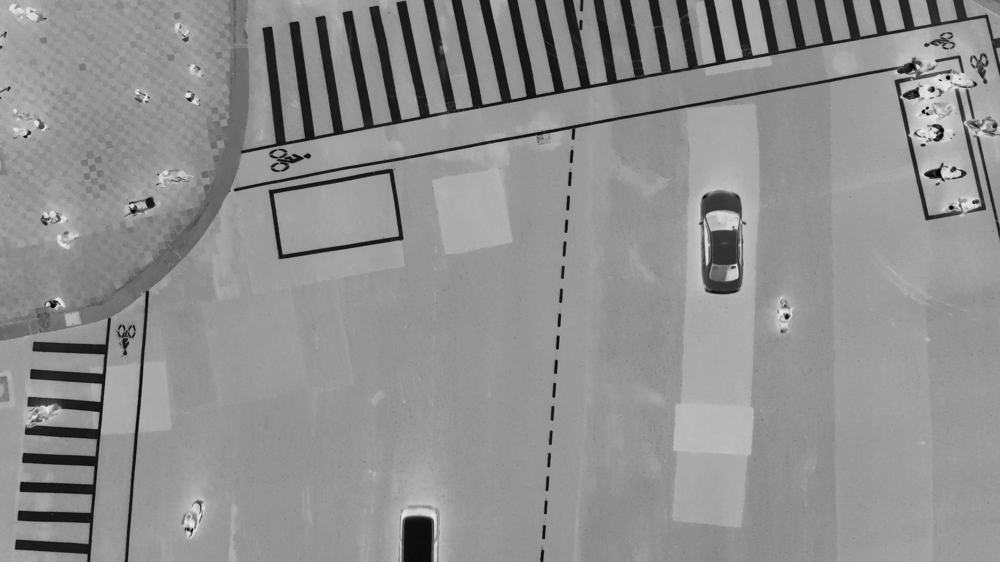

In [ ]:
inverter = transforms.RandomInvert() # inverte aleatoriamente as cores da imagem fornecida
invertered_img = inverter(img)
invertered_img

**4 - Verificando o resultado da transformação "RandomPosterize"**

Essa transformação altera a resolução radiométrica da imagem. Após diversos testes, verificou-se que a transformação para uma imagem de 4 bits seria a melhor alteração, criando uma nova imagem que mantivesse os detalhes principais da imagem original (isto é, de modo que pudessem ser observados os  principais elementos da imagem, especialmente as pessoas).

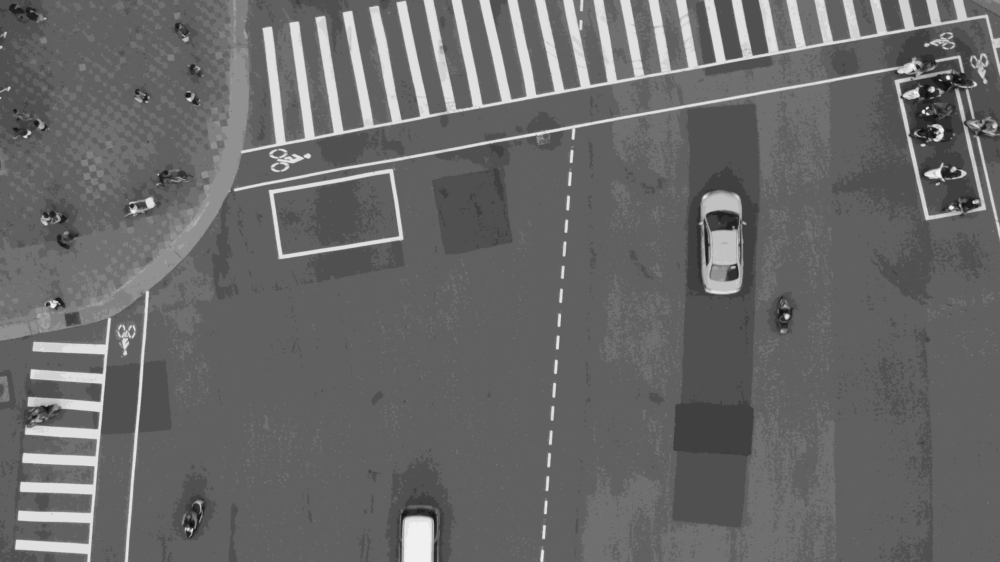

In [ ]:
posterizer = transforms.RandomPosterize(bits=4) # Altera resolução radiométrica
posterized_img = posterizer(img)
posterized_img

**5 - Verificando o resultado da transformação "RandomSolarize"**

Após alguns testes, verificou-se que o threshold = 20 é o limite que melhor modifica a imagem, possibilitando, ainda, que sejam detectadas pessoas na imagem.

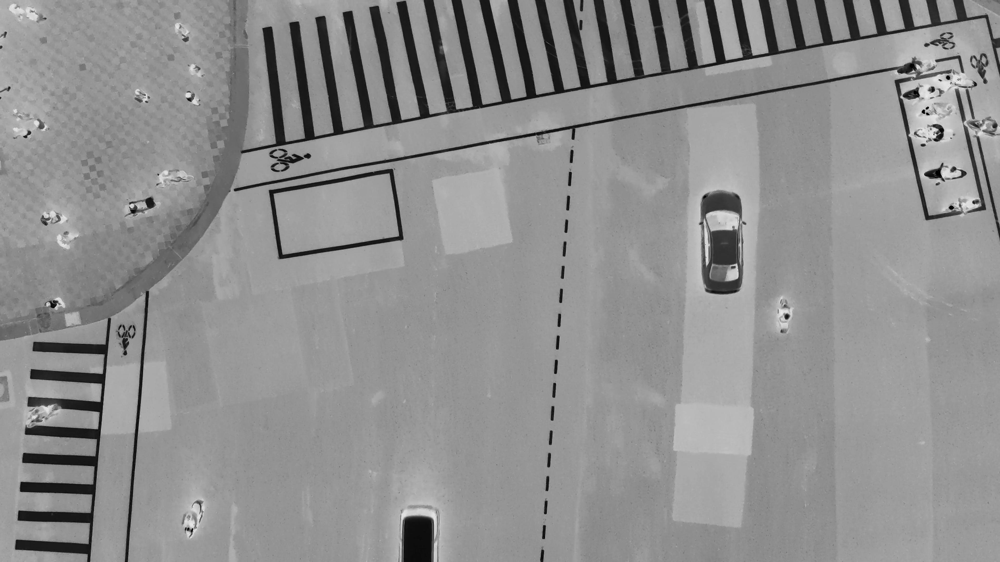

In [ ]:
solarizer = transforms.RandomSolarize(threshold=20) # invertendo todos os valores de pixel acima do limite
solarized_img = solarizer(img)
solarized_img

**6 - Verificando o resultado da transformação "RandomAdjustSharpness"**

Após alguns testes, optou-se por adotar o fator de nitidez igual a 25 (sharpness_factor=25), uma vez que se tem uma pequena modificação na imagem, não comprometendo a detecção das pessoas presentes na mesma.

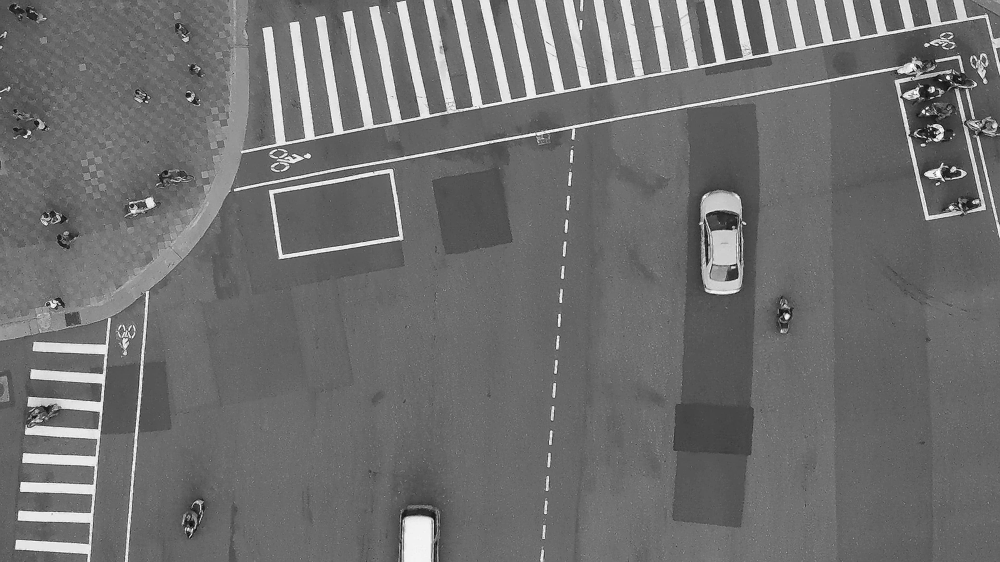

In [ ]:
sharpness_adjuster = transforms.RandomAdjustSharpness(sharpness_factor=25) #ajusta aleatoriamente a nitidez da imagem
sharpened_img = sharpness_adjuster(img)
sharpened_img

**7 - Verificando o resultado da transformação "RandomAutocontrast"**

Essa transformação não foi adotada para aumentação dos dados pois não foi possível notar diferenças na imagem antes e após a transformação (ao menos visualmente a diferença é imperceptível).

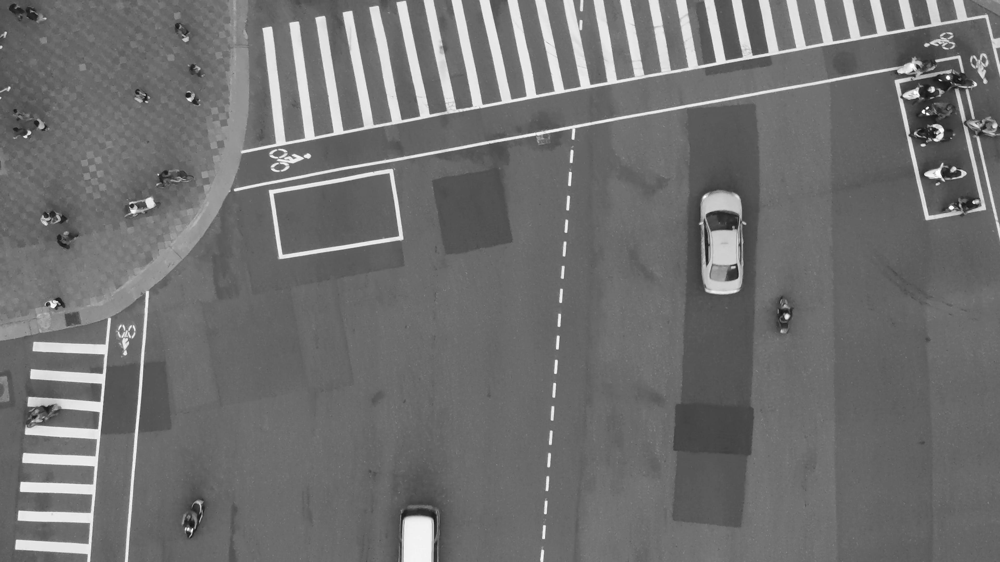

In [ ]:
autocontraster = transforms.RandomAutocontrast() # aplica o contraste automático aleatoriamente à imagem fornecida
autocontrasted_img = autocontraster(img)
autocontrasted_img
# Não adotar: não observa-se diferenças na imagem após aplicar a transformação (visualmente imperceptível)

**8 - Verificando o resultado da transformação "RandomEqualize"**

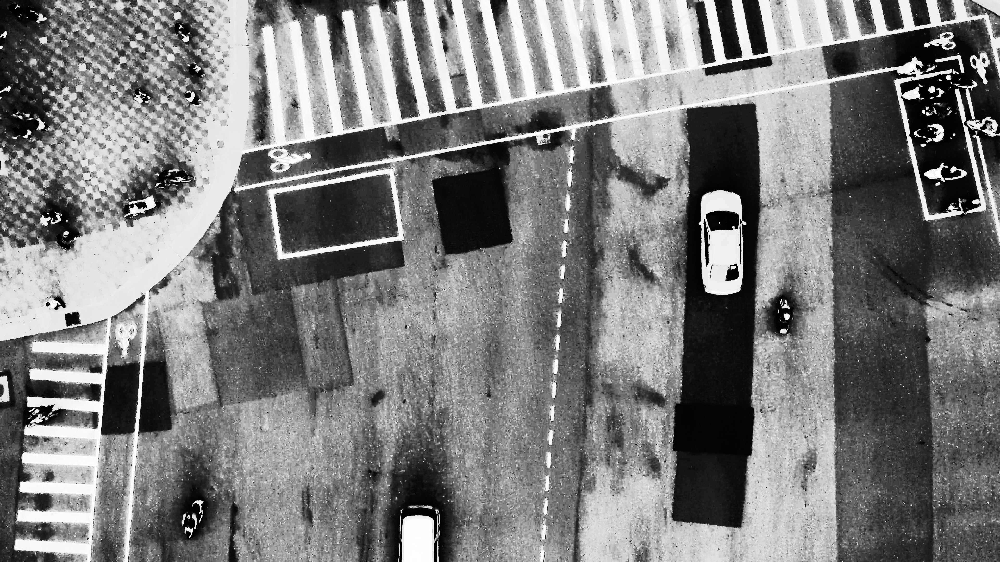

In [ ]:
equalizer = transforms.RandomEqualize() #equaliza aleatoriamente o histograma da imagem fornecida.
equalized_img = equalizer(img)
equalized_img

**9 - Verificando o resultado da transformação "TrivialAugmentWide"**

Essa transformação não foi adotada para aumentação dos dados pois pode rotacionar, transladar e escalonar a imagem, o que interfere nos rótulos da imagem (bounding box das pessoas detectadas na imagem).

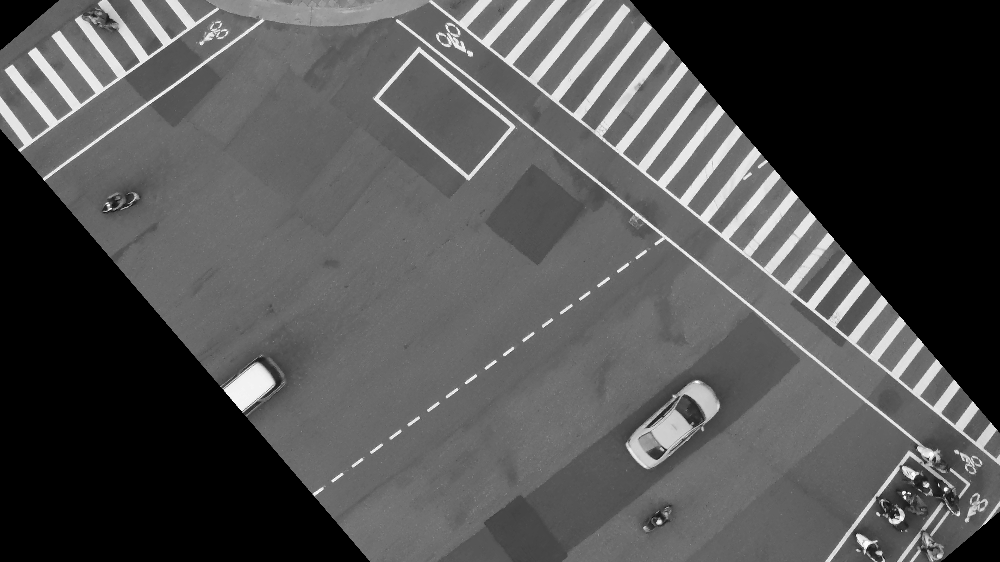

In [ ]:
trivial_augmenter = transforms.TrivialAugmentWide() #aumenta automaticamente os dados
img_trivial = trivial_augmenter(img)
img_trivial
# Não será adotado pois, a cada transformação, pode gerar uma alteração diferente, incluindo a rotação da imagem, como no exemplo.

Ao final dos testes realizados, as seguintes transformações foram adotadas para aumentação dos dados:

- ColorJitter([brilho contraste, …]): altere aleatoriamente o brilho, contraste, saturação e matiz de uma imagem;
-  RandomInvert: inverte aleatoriamente as cores da imagem fornecida;
- RandomPosterize: reduz o número de bits para cada canal de cor;
- RandomSolarize: inverte todos os valores de pixel acima de um limite;
- RandomAdjustSharpness(fator de nitidez[, p]): ajusta a nitidez da imagem aleatoriamente com uma determinada probabilidade.
- RandomEqualize: equaliza o histograma da imagem fornecida.

Referência: https://pytorch.org/vision/0.12/transforms.html


## Aumentando os dados de treino

In [ ]:
train_dataset_img = "gdrive/MyDrive/IA901_Projeto/Dados_pre_processing/NC_augmentation/train/images"
train_dataset_labels = "gdrive/MyDrive/IA901_Projeto/Dados_pre_processing/NC_augmentation/train/labels"
list_files_img = os.listdir(train_dataset_img)

A seguir, são aplicadas as seis transformações definidas para aumentação dos dados, considerando, para cada uma delas, um conjunto aleatório de 230 imagens pertencentes ao dataset de treino.

Assim, a cada transformação, 230 novas imagens são geradas e salvas na pasta correspondente ao dataset de treino, para serem adotadas durante o treinamento dos dados.

Obs.: os rótulos correspondentes a cada imagem também são salvos, considerando o nome da imagem após a transformação.

#### 1 - Transformação: ColorJitter

In [ ]:
# 230 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files_img), (230))

for i in range(len(random_samples)):
  img_file = train_dataset_img + '/' + list_files_img[random_samples[i]]
  img = Image.open(img_file)

  jitter = transforms.ColorJitter(brightness=.9, hue=0.5)
  jitted_img = jitter(img)
  jitted_img.save(os.path.join(train_dataset_img,'1_'+ list_files_img[random_samples[i]]))

  # Copiando o arquivo de labels (com o nome da imagem modificada)
  nome_img, extensao = os.path.splitext(list_files_img[random_samples[i]]) # Separa o nome do arquivo da sua extensão
  fonte = train_dataset_labels + '/' +  nome_img + '.txt'
  destino = train_dataset_labels + '/1_' +  nome_img + '.txt'
  shutil.copyfile(fonte, os.path.join(destino))

  i=i+1

#### 2 - Transformação: RandomInvert

In [ ]:
# 230 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files_img), (230))

for i in range(len(random_samples)):
  img_file = train_dataset_img + '/' + list_files_img[random_samples[i]]
  img = Image.open(img_file)

  inverter = transforms.RandomInvert() # inverte aleatoriamente as cores da imagem fornecida
  invertered_img = inverter(img)
  invertered_img.save(os.path.join(train_dataset_img,'2_'+ list_files_img[random_samples[i]]))

  # Copiando o arquivo de labels (com o nome da imagem modificada)
  nome_img, extensao = os.path.splitext(list_files_img[random_samples[i]]) # Separa o nome do arquivo da sua extensão
  fonte = train_dataset_labels + '/' +  nome_img + '.txt'
  destino = train_dataset_labels + '/2_' +  nome_img + '.txt'
  shutil.copyfile(fonte, os.path.join(destino))

  i=i+1

#### 3 - Transformação: RandomPosterize

In [ ]:
# 230 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files_img), (230))

for i in range(len(random_samples)):
  img_file = train_dataset_img + '/' + list_files_img[random_samples[i]]
  img = Image.open(img_file)

  posterizer = transforms.RandomPosterize(bits=4) # Altera resolução radiométrica
  posterized_img = posterizer(img)
  posterized_img.save(os.path.join(train_dataset_img,'3_'+ list_files_img[random_samples[i]]))

  # Copiando o arquivo de labels (com o nome da imagem modificada)
  nome_img, extensao = os.path.splitext(list_files_img[random_samples[i]]) # Separa o nome do arquivo da sua extensão
  fonte = train_dataset_labels + '/' +  nome_img + '.txt'
  destino = train_dataset_labels + '/3_' +  nome_img + '.txt'
  shutil.copyfile(fonte, os.path.join(destino))

  i=i+1

#### 4 - Transformação: RandomSolarize

In [ ]:
# 230 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files_img), (230))

for i in range(len(random_samples)):
  img_file = train_dataset_img + '/' + list_files_img[random_samples[i]]
  img = Image.open(img_file)

  solarizer = transforms.RandomSolarize(threshold=20) # invertendo todos os valores de pixel acima do limite
  solarized_img = solarizer(img)
  solarized_img.save(os.path.join(train_dataset_img,'4_'+ list_files_img[random_samples[i]]))

  # Copiando o arquivo de labels (com o nome da imagem modificada)
  nome_img, extensao = os.path.splitext(list_files_img[random_samples[i]]) # Separa o nome do arquivo da sua extensão
  fonte = train_dataset_labels + '/' +  nome_img + '.txt'
  destino = train_dataset_labels + '/4_' +  nome_img + '.txt'
  shutil.copyfile(fonte, os.path.join(destino))

  i=i+1

#### 5 - Transformação: RandomAdjustSharpness

In [ ]:
# 230 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files_img), (230))

for i in range(len(random_samples)):
  img_file = train_dataset_img + '/' + list_files_img[random_samples[i]]
  img = Image.open(img_file)

  sharpness_adjuster = transforms.RandomAdjustSharpness(sharpness_factor=25) #ajusta aleatoriamente a nitidez da imagem
  sharpened_img = sharpness_adjuster(img)
  sharpened_img.save(os.path.join(train_dataset_img,'5_'+ list_files_img[random_samples[i]]))

  # Copiando o arquivo de labels (com o nome da imagem modificada)
  nome_img, extensao = os.path.splitext(list_files_img[random_samples[i]]) # Separa o nome do arquivo da sua extensão
  fonte = train_dataset_labels + '/' +  nome_img + '.txt'
  destino = train_dataset_labels + '/5_' +  nome_img + '.txt'
  shutil.copyfile(fonte, os.path.join(destino))

  i=i+1

#### 6 - Transformação: RandomEqualize

In [ ]:
# 230 random images from the training dataset
random_samples = np.random.randint(
    1, len(list_files_img), (230))

for i in range(len(random_samples)):
  img_file = train_dataset_img + '/' + list_files_img[random_samples[i]]
  img = Image.open(img_file)

  equalizer = transforms.RandomEqualize() #equaliza aleatoriamente o histograma da imagem fornecida.
  equalized_img = equalizer(img)
  equalized_img.save(os.path.join(train_dataset_img,'6_'+ list_files_img[random_samples[i]]))

  # Copiando o arquivo de labels (com o nome da imagem modificada)
  nome_img, extensao = os.path.splitext(list_files_img[random_samples[i]]) # Separa o nome do arquivo da sua extensão
  fonte = train_dataset_labels + '/' +  nome_img + '.txt'
  destino = train_dataset_labels + '/6_' +  nome_img + '.txt'
  shutil.copyfile(fonte, os.path.join(destino))

  i=i+1